In [ ]:
# Temperature Data Analysis and Visualization
#This notebook contains an analysis of temperature data from NOAA near Ann Arbor, Michigan, for the years 2005-2015.


In [ ]:
## 1. Data Loading
# We begin by loading the NOAA temperature dataset and inspecting the first few rows to understand its structure.


In [4]:
import pandas as pd

# Load the temperature data
temperature_df = pd.read_csv('/content/temperature (1).csv')

# Load the bin size data if needed
binsize_df = pd.read_csv('/content/BinSize (1).csv')

# Display the first few rows of the data to understand its structure
temperature_df.head()


,ID,Date,Element,Data_Value
0,USW00094889,2014-11-12,TMAX,22
1,USC00208972,2009-04-29,TMIN,56
2,USC00200032,2008-05-26,TMAX,278
3,USC00205563,2005-11-11,TMAX,139
4,USC00200230,2014-02-27,TMAX,-106


In [ ]:
## 2. Data Preprocessing
# We preprocess the data by removing leap day (February 29th) and filtering the data for the years 2005-2014.


In [6]:
# Convert the 'date' column to datetime format
temperature_df['Date'] = pd.to_datetime(temperature_df['Date'])

# Remove February 29 (leap days) from the dataset
temperature_df = temperature_df[~((temperature_df['Date'].dt.month == 2) & (temperature_df['Date'].dt.day == 29))]

# Check the processed data
temperature_df.head()


,ID,Date,Element,Data_Value
0,USW00094889,2014-11-12,TMAX,22
1,USC00208972,2009-04-29,TMIN,56
2,USC00200032,2008-05-26,TMAX,278
3,USC00205563,2005-11-11,TMAX,139
4,USC00200230,2014-02-27,TMAX,-106


In [ ]:
## 3. Data Analysis
# We calculate the record high and low temperatures for each day of the year over the period 2005-2014.


In [10]:
# Filter for the years 2005-2014
temp_2005_2014 = temperature_df[(temperature_df['Date'].dt.year >= 2005) & (temperature_df['Date'].dt.year <= 2014)]

# Group by day of the year and find the record highs and lows
daily_temps = temp_2005_2014.groupby(temp_2005_2014['Date'].dt.strftime('%m-%d')).agg({
    'Data_Value': ['min', 'max']
}).reset_index()

# Rename columns for clarity
daily_temps.columns = ['Day_of_Year', 'Record_Low', 'Record_High']

# Display the aggregated data
daily_temps.head()


,Day_of_Year,Record_Low,Record_High
0,01-01,-160,156
1,01-02,-267,139
2,01-03,-267,133
3,01-04,-261,106
4,01-05,-150,128


In [11]:
# Filter for the year 2015
temp_2015 = temperature_df[temperature_df['Date'].dt.year == 2015]

# Merge with daily_temps to compare 2015 data with record highs/lows
temp_2015['Day_of_Year'] = temp_2015['Date'].dt.strftime('%m-%d')
merged = pd.merge(temp_2015, daily_temps, on='Day_of_Year')

# Identify broken records
broken_records = merged[
    ((merged['Data_Value'] > merged['Record_High']) & (merged['Element'] == 'TMAX')) |
    ((merged['Data_Value'] < merged['Record_Low']) & (merged['Element'] == 'TMIN'))
]

# Display records broken in 2015
broken_records.head()


<ipython-input-11-ed6d8704940a>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp_2015['Day_of_Year'] = temp_2015['Date'].dt.strftime('%m-%d')


,ID,Date,Element,Data_Value,Day_of_Year,Record_Low,Record_High
295,USW00014833,2015-01-05,TMIN,-155,01-05,-150,128
608,USC00200228,2015-12-13,TMAX,167,12-13,-178,111
611,USW00014833,2015-12-13,TMAX,161,12-13,-178,111
612,USC00202308,2015-12-13,TMAX,178,12-13,-178,111
615,USC00207308,2015-12-13,TMAX,178,12-13,-178,111


In [ ]:
## 4. Visualization
# We create a line graph showing record high and low temperatures by day of the year. The area between these values is shaded. We also overlay a scatter plot for 2015 data points where records were broken.


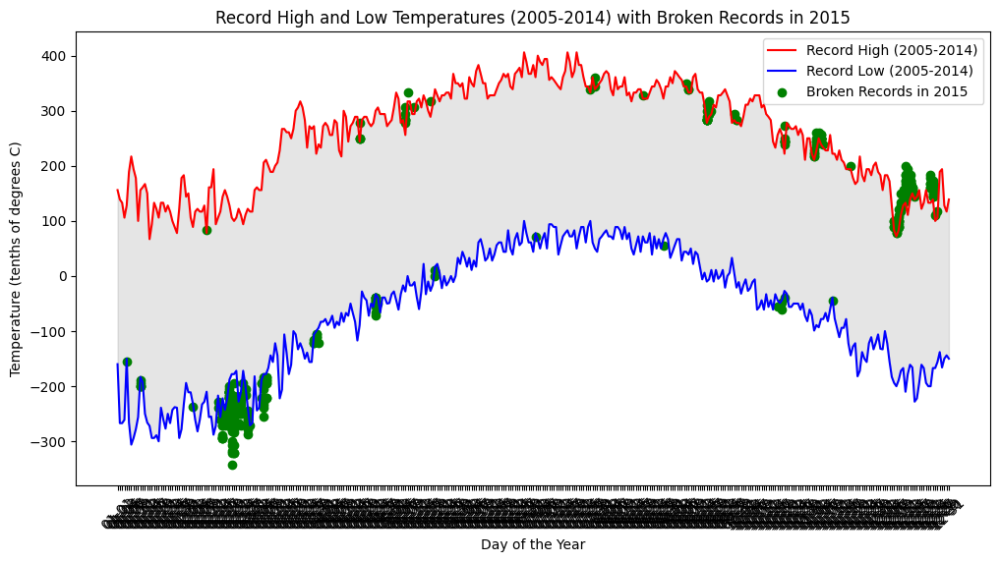

In [12]:
import matplotlib.pyplot as plt

# Plotting the record highs and lows
plt.figure(figsize=(12, 6))
plt.plot(daily_temps['Day_of_Year'], daily_temps['Record_High'], label='Record High (2005-2014)', color='red')
plt.plot(daily_temps['Day_of_Year'], daily_temps['Record_Low'], label='Record Low (2005-2014)', color='blue')
plt.fill_between(daily_temps['Day_of_Year'], daily_temps['Record_Low'], daily_temps['Record_High'], color='gray', alpha=0.2)

# Overlay broken records in 2015
plt.scatter(broken_records['Day_of_Year'], broken_records['Data_Value'], color='green', label='Broken Records in 2015')

# Adding titles and labels
plt.title('Record High and Low Temperatures (2005-2014) with Broken Records in 2015')
plt.xlabel('Day of the Year')
plt.ylabel('Temperature (tenths of degrees C)')
plt.xticks(rotation=45)
plt.legend()

# Show the plot
plt.show()


In [15]:
binsize_df.head()

,ID,LATITUDE,LONGITUDE,ELEVATION,STATE,NAME,GSNFLAG,HCNFLAG,WMOID,x,y,x_group,y_group,xy_group,hash
0,AE000041196,25.333,55.517,34.0,NaN,SHARJAH INTER. AIRP,GSN,NaN,41196.0,5.579578e+06,2.816905e+06,5497601.479782179 to 5594934.908498545,2772265.475723952 to 2869598.904440318,"5497601.479782179 to 5594934.908498545, 277226...",1f6f0e89f4e937d934fe9acde2545e0d66bbcfe3b66320...
1,AEM00041194,25.255,55.364,10.4,NaN,DUBAI INTL,NaN,NaN,41194.0,5.567782e+06,2.808232e+06,5497601.479782179 to 5594934.908498545,2772265.475723952 to 2869598.904440318,"5497601.479782179 to 5594934.908498545, 277226...",1f6f0e89f4e937d934fe9acde2545e0d66bbcfe3b66320...
2,AEM00041217,24.433,54.651,26.8,NaN,ABU DHABI INTL,NaN,NaN,41217.0,5.532707e+06,2.716829e+06,5497601.479782179 to 5594934.908498545,2674932.047007587 to 2772265.4757239525,"5497601.479782179 to 5594934.908498545, 267493...",35c9093084d26708afc5b482ea15ba52e3f20fb7cd781f...
3,AEM00041218,24.262,55.609,264.9,NaN,AL AIN INTL,NaN,NaN,41218.0,5.637301e+06,2.697815e+06,5594934.908498544 to 5692268.33721491,2674932.047007587 to 2772265.4757239525,"5594934.908498544 to 5692268.33721491, 2674932...",2a6a7edad90579049fd1b3c3a990e8a8be90cb1975118e...
4,AFM00040990,31.500,65.850,1010.0,NaN,KANDAHAR AIRPORT,NaN,NaN,40990.0,6.243199e+06,3.502645e+06,6178935.480796736 to 6276268.909513102,3453599.476738509 to 3550932.9054548745,"6178935.480796736 to 6276268.909513102, 345359...",039e75bbef55baa3fecc0568dc3b245666a98b1bcba6b4...


In [ ]:
## 5. Mapping Station Locations
# We visualize the location of weather stations on a map centered around Ann Arbor, Michigan. We use the `folium` library for this interactive map.


In [13]:
!pip install folium
import folium


In [16]:
# Create a map centered around Ann Arbor, Michigan
ann_arbor_map = folium.Map(location=[42.2808, -83.7430], zoom_start=4)  # Adjust zoom level for better visualization


In [17]:
# Loop through the stations and add markers to the map
for _, row in binsize_df.iterrows():
    folium.Marker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        popup=row['NAME'],  # Display the station name on click
        tooltip=row['ID']   # Display the station ID on hover
    ).add_to(ann_arbor_map)

# Display the map
ann_arbor_map


In [18]:
# Save the map as an HTML file
ann_arbor_map.save('ann_arbor_stations_map.html')


In [ ]:
## Installation
install the following Python libraries:

- pandas
- matplotlib
- folium
